In [2]:
import ipdb
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import matplotlib.pylab as pylab
import cartopy
from utils import constants as cnst
from eod import msg
from utils import u_grid, u_interpolate as u_int, constants as cnst, u_arrays, u_darrays, u_met
import pandas as pd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as feature
import cartopy.io.shapereader as shapereader


coast = shapereader.natural_earth(resolution='110m',
                                  category='physical',
                                  name='coastline')

countries = shapereader.natural_earth(resolution='110m',
                                      category='cultural',
                                      name='admin_0_countries')

pylab.rcParams['figure.figsize'] = (50., 50.)
%matplotlib inline

In [1]:
cd ..

/home/ck/pythonWorkspace/proj_CEH


In [3]:
file = cnst.MCS_CENTRE70

In [13]:
msg = xr.open_dataarray(file)

msg = msg[((msg['time.hour'] == 18 )) & (msg['time.minute'] == 0) & (
msg['time.year'] >= 2006) & (msg['time.year'] <= 2010) & (msg['time.month'] >=6) ]

In [14]:
msg

<xarray.DataArray 'blob' (time: 608, lat: 253, lon: 519)>
[79834656 values with dtype=float64]
Coordinates:
  * lon      (lon) float64 -11.66 -11.62 -11.57 -11.53 ... 11.51 11.56 11.6
  * lat      (lat) float64 8.986 9.03 9.075 9.119 ... 19.87 19.91 19.95 19.99
  * time     (time) datetime64[ns] 2006-06-01T18:00:00 ... 2010-09-30T18:00:00

In [15]:
test = msg.where(msg.values == 1, other=0)

In [16]:
np.unique(test.values)

array([0., 1.])

In [17]:
checkbox = test.sel(lon=slice(-2.5,-0.5), lat=slice(11.5,13.5)).sum(['lat','lon']) # ouaga
#checkbox = test.sel(lon=slice(1,2), lat=slice(12.5,14.5)).sum(['lat','lon'])

In [18]:
outtime = checkbox.where(checkbox>0, drop=True)

In [19]:
tab = outtime['time'].values

In [20]:
len(tab)

12

In [21]:
def cut_kernel(xpos, ypos, arr, date, lon, lat):

    #AMSRE 0.25 degrees ~ 27.5 km
    dist = 10

    kernel = u_arrays.cut_kernel(arr,xpos, ypos,dist)


    # if (np.sum(np.isfinite(kernel)) < 0.10 * kernel.size):
    #     return

    kernel3 = kernel - np.nanmean(kernel)

    cnt = np.zeros_like(kernel)
    cnt[np.isfinite(kernel)] = 1

    if kernel.shape != (dist*2+1, dist*2+1):
        return None

    return kernel, kernel3, cnt

In [112]:
def run(shift, date, hour):
    dic = {
    'q' : [],
    't' : [],
    'u' : [],
    'v' : [],
    'w' : [],
    'u_orig' : [],
    'v_orig' : [],        
    'd' : [],
    't2' : [],
    'u100' : [],
    'v100' : [],
    'u100_orig' : [],
    'v100_orig' : [],
    'slp' : [],
    'cnt' : [],
    'mcc' : [],
    'hcc' : [],
    'cape' : [],
    'divMoist' : [],
    'ice' : [],
    'ice_orig' : [],
    'sh' : [],
    'rh' : [],
    'zshear' : []
    }
    
    clim = '/home/ck/DIR/mymachine/ERA5/monthly/synop_selfmade/CLIM_2000-2014/'
    
    #box = [-4.5,3.5,9,15]
    box = [-10,10,5,18]


    tab = date
    single = date
       
    dt = pd.to_datetime(date)


    daystring = str(abs(shift))
    dayd = pd.Timedelta(daystring + 'days')
    if shift < 0:
        dt = dt - dayd
    if shift >=0:
        dt = dt + dayd

    window1 = dt - pd.Timedelta('7days')
    window2 = dt + pd.Timedelta('7days')


    fdate = '_' + str(dt.year) +'_' + str(dt.month).zfill(2) + '_'# + str(dt.day).zfill(2)

    hour = hour
    shour = hour

    try:

        lsta = xr.open_dataset(cnst.ERA5 + 'hourly/pressure_levels/ERA5' + fdate + 'pl.nc') #sma  #'AMSR_L3_LPRMv05_A_'
        lsta_clim = xr.open_dataset(clim + \
                        'pressure_levels/ERA5_2000-2014_CLIM_' + str(dt.month).zfill(2) + '-'+str(hour).zfill(2)+'_pl.nc')

        srfc = xr.open_dataset(cnst.ERA5 + 'hourly/surface/ERA5' + fdate + 'srfc.nc') #sma  #'AMSR_L3_LPRMv05_A_'
        srfc_clim = xr.open_dataset(clim + \
                        'surface/ERA5_2000-2014_CLIM_' + str(dt.month).zfill(2) + '-'+str(hour).zfill(2)+'_srfc.nc')

    except:
        print('File missing', cnst.ERA5  + 'hourly/pressure_levels/ERA5' + fdate + 'pl.nc')
        return

    lsta = u_darrays.flip_lat(lsta)
    srfc = u_darrays.flip_lat(srfc)


    lsta = lsta.sel(longitude=slice(box[0], box[1]), latitude=slice(box[2],box[3]))
    lsta_clim = lsta_clim.sel(lon=slice(box[0], box[1]), lat=slice(box[2],box[3]))

    srfc = srfc.sel(longitude=slice(box[0], box[1]), latitude=slice(box[2],box[3]))
    srfc_clim = srfc_clim.sel(lon=slice(box[0], box[1]), lat=slice(box[2],box[3]))

    pos = np.where(lsta['time.hour']==shour)
    if np.sum(pos) == 0:
        return

    try:
        lsta_low = lsta.sel(time=str(dt.year)+'-'+str(dt.month)+'-'+str(dt.day)+'T'+str(hour).zfill(2)+':00:00', level=925)
    except:
        return
    lsta_up = lsta.sel(time=str(dt.year)+'-'+str(dt.month)+'-'+str(dt.day)+'T'+str(hour).zfill(2)+':00:00', level=650)

    srfc_low = srfc.sel(time=str(dt.year)+'-'+str(dt.month)+'-'+str(dt.day)+'T'+str(hour).zfill(2)+':00:00')

    lsta10 = lsta.isel(time=pos[0])
    lsta10_low = lsta10.sel(time=slice(str(window1.year)+'-'+str(window1.month)+'-'+str(window1.day)+'T'+str(shour).zfill(2)+':00:00' , \
                                  str(window2.year)+'-'+str(window2.month)+'-'+str(window2.day)+'T'+str(shour).zfill(2)+':00:00'), level=925)

    lsta10_up = lsta10.sel(time=slice(str(window1.year)+'-'+str(window1.month)+'-'+str(window1.day)+'T'+str(shour).zfill(2)+':00:00' , \
                                  str(window2.year)+'-'+str(window2.month)+'-'+str(window2.day)+'T'+str(shour).zfill(2)+':00:00'), level=650)



#         lsta10_low = lsta10.sel(time=str(dt.year)+'-'+str(dt.month)+'-'+str(dt.day)+'T'+str(shour).zfill(2)+':00:00', level=925)

#         lsta10_up = lsta10.sel(time=str(dt.year)+'-'+str(dt.month)+'-'+str(dt.day)+'T'+str(shour).zfill(2)+':00:00', level=650)




    pos = np.where(srfc['time.hour']==shour)
    #ipdb.set_trace()
    srfc10 = srfc.isel(time=pos[0])
    srfc10 = srfc10.sel(time=slice(str(window1.year)+'-'+str(window1.month)+'-'+str(window1.day)+'T'+str(shour).zfill(2)+':00:00' , \
                                  str(window2.year)+'-'+str(window2.month)+'-'+str(window2.day)+'T'+str(shour).zfill(2)+':00:00'))


#         srfc10 = srfc.isel(time=pos[0])
#         srfc10 = srfc10.sel(time=str(dt.year)+'-'+str(dt.month)+'-'+str(dt.day)+'T'+str(shour).zfill(2)+':00:00' )




    lsta_clim_low = lsta_clim.sel(level=925)
    lsta_clim_up = lsta_clim.sel(level=650)

    #ipdb.set_trace()

    q = lsta_low['q'].squeeze()
    u = lsta_up['u'].squeeze()
    v = lsta_up['v'].squeeze()
    w = lsta_low['w'].squeeze()
    t = lsta_low['t'].squeeze()
    d = lsta_low['d'].squeeze()
    rh = lsta_low['r'].squeeze()
    t2 = srfc_low['t2m'].squeeze()
    u100 = srfc_low['u10'].squeeze()
    v100 = srfc_low['v10'].squeeze()
    slp = srfc_low['sp'].squeeze()
    cape = srfc_low['cape'].squeeze()
    hcc = srfc_low['hcc'].squeeze()
    mcc = srfc_low['mcc'].squeeze()
    divMoist = srfc_low['p84.162'].squeeze()
    ice = srfc_low['tciw'].squeeze()
    sh = srfc_low['ishf'].squeeze()

    q_clim = lsta10_low['q'].squeeze().mean('time')
    u_clim = lsta10_up['u'].squeeze().mean('time')
    v_clim = lsta10_up['v'].squeeze().mean('time')
    w_clim = lsta10_low['w'].squeeze().mean('time')
    t_clim = lsta10_low['t'].squeeze().mean('time')
    rh_clim = lsta10_low['r'].squeeze().mean('time')
    d_clim = lsta10_low['d'].squeeze().mean('time')
    t2_clim = srfc10['t2m'].squeeze().mean('time')
    u100_clim = srfc10['u10'].squeeze().mean('time')
    v100_clim = srfc10['v10'].squeeze().mean('time')
    slp_clim = srfc10['sp'].squeeze().mean('time')
    cape_clim = srfc10['cape'].squeeze().mean('time')
    hcc_clim = srfc10['hcc'].squeeze().mean('time')
    mcc_clim = srfc10['mcc'].squeeze().mean('time')
    divMoist_clim = srfc10['p84.162'].squeeze().mean('time')
    ice_clim = srfc10['tciw'].squeeze().mean('time')
    sh_clim = srfc10['ishf'].squeeze().mean('time')

#         q_clim = lsta10_low['q'].squeeze()
#         u_clim = lsta10_up['u'].squeeze()
#         v_clim = lsta10_up['v'].squeeze()
#         w_clim = lsta10_low['w'].squeeze()
#         t_clim = lsta10_low['t'].squeeze()
#         rh_clim = lsta10_low['r'].squeeze()
#         d_clim = lsta10_low['d'].squeeze()
#         t2_clim = srfc10['t2m'].squeeze()
#         u100_clim = srfc10['u100'].squeeze()
#         v100_clim = srfc10['v100'].squeeze()
#         slp_clim = srfc10['sp'].squeeze()
#         cape_clim = srfc10['cape'].squeeze()
#         hcc_clim = srfc10['hcc'].squeeze()
#         mcc_clim = srfc10['mcc'].squeeze()
#         divMoist_clim = srfc10['p84.162']
#         ice_clim = srfc10['tciw'].squeeze()
#         sh_clim = srfc10['ishf'].squeeze()

#     q_clim = lsta_clim_low['q'].squeeze()
#     u_clim = lsta_clim_up['u'].squeeze()
#     v_clim = lsta_clim_up['v'].squeeze()
#     w_clim = lsta_clim_low['w'].squeeze()
#     t_clim = lsta_clim_low['t'].squeeze()
#     rh_clim = lsta_clim_low['r'].squeeze()
#     d_clim = lsta_clim_low['d'].squeeze()
#     t2_clim = srfc_clim['t2m'].squeeze()
#     u100_clim = srfc_clim['u100'].squeeze()
#     v100_clim = srfc_clim['v100'].squeeze()
#     slp_clim = srfc_clim['sp'].squeeze()
#     cape_clim = srfc_clim['cape'].squeeze()
#     hcc_clim = srfc_clim['hcc'].squeeze()
#     mcc_clim = srfc_clim['mcc'].squeeze()
#     divMoist_clim = srfc_clim['p84.162'].squeeze()
#     ice_clim = srfc_clim['tciw'].squeeze()
#     sh_clim = srfc_clim['ishf'].squeeze()

    print('Doing '+ 'AMSR_' + str(dt.year) + str(dt.month).zfill(2) + str(
    dt.day).zfill(2) + '.nc')

    cnt = np.zeros_like(q.values)
    cnt[np.isfinite(q.values)] = 1

    dic['q'].append(q.values- q_clim.values)
    dic['v'].append(v.values- v_clim.values)
    dic['w'].append(w.values- w_clim.values)
    dic['u'].append(u.values- u_clim.values)
    dic['rh'].append(rh.values- rh_clim.values)
    dic['v_orig'].append(v.values)#
    dic['u_orig'].append(u.values)#
    dic['t'].append(t.values-t_clim.values)
    dic['d'].append(d.values-d_clim.values)
    dic['t2'].append(t2.values-t2_clim.values)
    dic['u100'].append(u100.values-u100_clim.values)
    dic['v100'].append(v100.values-v100_clim.values)
    dic['u100_orig'].append(u100.values)#
    dic['v100_orig'].append(v100.values)#
    dic['slp'].append(slp.values-slp_clim.values)
    dic['cape'].append(cape.values-cape_clim.values)#s-v100_clim.values)
    dic['hcc'].append(hcc.values-hcc_clim.values)
    dic['mcc'].append(mcc.values-mcc_clim.values)
    dic['divMoist'].append(divMoist.values-divMoist_clim.values)#-slp_clim.values)
    dic['ice'].append(ice.values-ice_clim.values)
    dic['ice_orig'].append(ice.values)
    dic['sh'].append(sh.values-sh_clim.values)
    ws, wd = u_met.u_v_to_ws_wd(u.values-u100.values, v.values-v100.values)
    wsclim, wd = u_met.u_v_to_ws_wd(u_clim.values-u100_clim.values, v_clim.values-v100_clim.values)
    dic['zshear'].append(ws-wsclim)
    dic['cnt'].append(cnt)

    lat = lsta_low.latitude.values
    lon = lsta_low.longitude.values

    for k in dic.keys():
        dic[k] = np.nansum(np.stack(dic[k], axis=0), axis=0)

    return dic, lat, lon

In [82]:
def calc(dic):
    
    dics = {}
    for k in dic.keys():
        if k == 'cnt':
            continue
        dics[k] = dic[k] / dic['cnt']
    return dics

In [105]:
dic, lat, lon = run(0, tab[10], 12)

Doing AMSR_20100828.nc


In [106]:
dic['t2']/dic['cnt']

array([[ 0.5597229 ,  0.71572876,  0.5303345 , ..., -0.28686523,
         0.16021729,  0.35668945],
       [ 0.25109863,  0.48962402,  1.0995789 , ..., -0.27700806,
         0.14971924,  0.5272217 ],
       [ 0.01028442,  0.7591858 ,  1.4064331 , ...,  0.09640503,
         0.57369995,  0.30444336],
       ...,
       [-1.2862854 , -1.3077087 , -1.6212463 , ..., -1.0827942 ,
        -1.3517456 , -1.657959  ],
       [-0.8674927 , -0.8836365 , -1.0371094 , ..., -1.1384888 ,
        -1.2252808 , -1.5117493 ],
       [-0.8334656 , -0.7839966 , -0.9458313 , ..., -1.0229492 ,
        -1.1806335 , -1.4508972 ]], dtype=float32)

In [107]:
dic = calc(dic)

In [108]:
def draw_map(ax, t, lat, lon, title='', levels=None, quiver=None, contour=None):
   
    plt.contourf(lon, lat, t, transform=ccrs.PlateCarree(), cmap='RdBu_r', levels=levels, extend='both')
    ax.coastlines()
    
    ax.plot(-1.51, 12.36,'bo')

    ## quiver list
    if quiver is not None:
        qu = ax.quiver(quiver['x'], quiver['y'], quiver['u'], quiver['v'],scale=quiver['scale'], width=0.003, headwidth=3.2)
    
    
        ## additional contour on plot   
    if contour is not None:
        contours = ax.contour(contour['x'], contour['y'], contour['data'], levels=contour['levels'], colors='red', linewidths=0.8 )
        plt.clabel(contours, inline=True, fontsize=7, fmt='%1.1f')
    
    # Gridlines
    xl = ax.gridlines(draw_labels=True);
    xl.xlabels_top = False
    xl.ylabels_right = False
    # Countries
    ax.add_feature(cartopy.feature.BORDERS, linestyle='--');
    plt.title(title)
    cbar = plt.colorbar()
    cbar.set_label('K')

In [109]:
np.arange(-1,1,5)

array([-1])

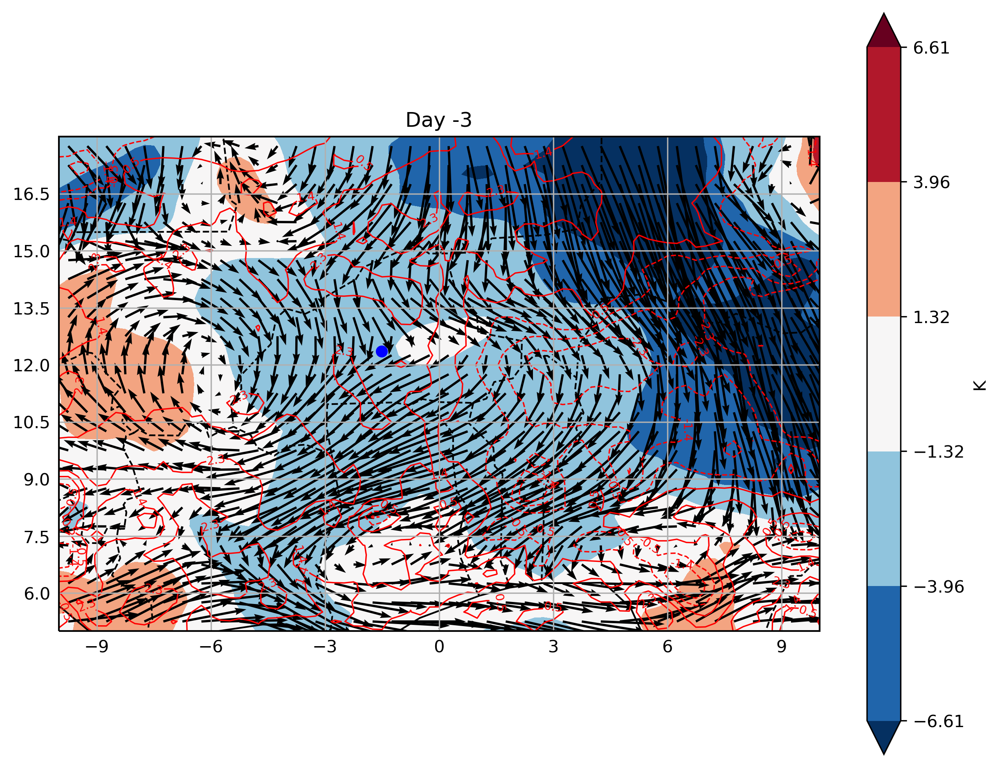

In [111]:
st=2
sarrow = 1
scale = 70
f = plt.figure(figsize=(10,8), dpi=300)

ax = f.add_subplot(111, projection=ccrs.PlateCarree())
lon2d, lat2d = np.meshgrid(lon,lat)
xquiv = lon2d[sarrow::st, sarrow::st]
yquiv = lat2d[sarrow::st, sarrow::st]


ws, wd = u_met.u_v_to_ws_wd(dic['u']-dic['u100'], dic['v']-dic['v100']) 
var = dic['v']
u = dic['u']
v = dic['v']
cvar = 't2'
edge = np.max([np.abs(np.percentile(dic[cvar],10)),np.abs(np.percentile(dic[cvar],90))])
levs = np.linspace(edge*-1,edge,6)
contour = {'data' : dic[cvar], 'x': lon, 'y' : lat, 'levels' : levs}

edge = np.max([np.abs(np.percentile(var,10)),np.abs(np.percentile(var,90))])
lev = np.linspace(edge*-1,edge,6)

uu = u[sarrow::st, sarrow::st]
vv = v[sarrow::st, sarrow::st]
qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : scale}
draw_map(ax, var, lat, lon, title='Day -3',  quiver=qin, levels=lev, contour=contour)

-3
Doing AMSR_20060611.nc
-2
Doing AMSR_20060612.nc
-1
Doing AMSR_20060613.nc
0
Doing AMSR_20060614.nc
1
Doing AMSR_20060615.nc
2
Doing AMSR_20060616.nc
-3
Doing AMSR_20060620.nc
-2
Doing AMSR_20060621.nc
-1
Doing AMSR_20060622.nc
0
Doing AMSR_20060623.nc
1
Doing AMSR_20060624.nc
2
Doing AMSR_20060625.nc
-3
Doing AMSR_20060831.nc
-2
Doing AMSR_20060901.nc
-1
Doing AMSR_20060902.nc
0
Doing AMSR_20060903.nc
1
Doing AMSR_20060904.nc
2
Doing AMSR_20060905.nc
-3
Doing AMSR_20060909.nc
-2
Doing AMSR_20060910.nc
-1
Doing AMSR_20060911.nc
0
Doing AMSR_20060912.nc
1
Doing AMSR_20060913.nc
2
Doing AMSR_20060914.nc
-3
Doing AMSR_20080531.nc
-2
Doing AMSR_20080601.nc
-1
Doing AMSR_20080602.nc
0
Doing AMSR_20080603.nc
1
Doing AMSR_20080604.nc
2
Doing AMSR_20080605.nc
-3
Doing AMSR_20080715.nc
-2
Doing AMSR_20080716.nc
-1
Doing AMSR_20080717.nc
0
Doing AMSR_20080718.nc
1
Doing AMSR_20080719.nc
2
Doing AMSR_20080720.nc
-3
Doing AMSR_20080728.nc
-2
Doing AMSR_20080729.nc
-1
Doing AMSR_20080730.nc
0
Do

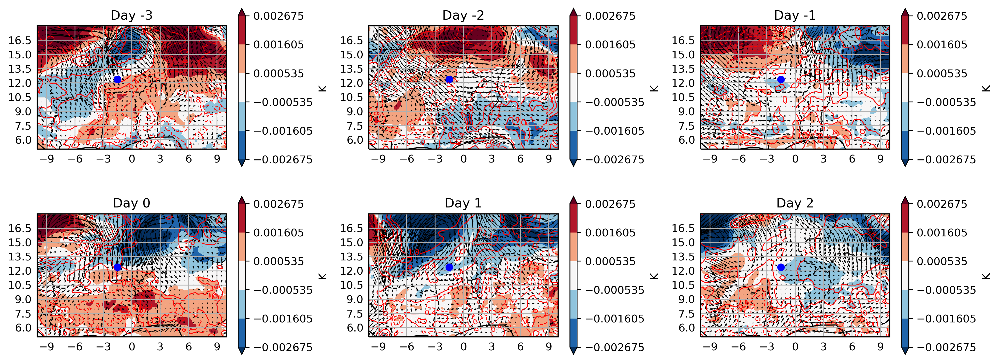

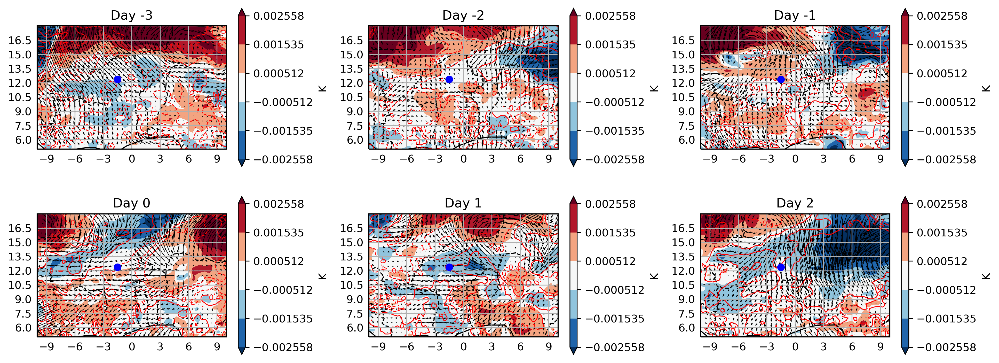

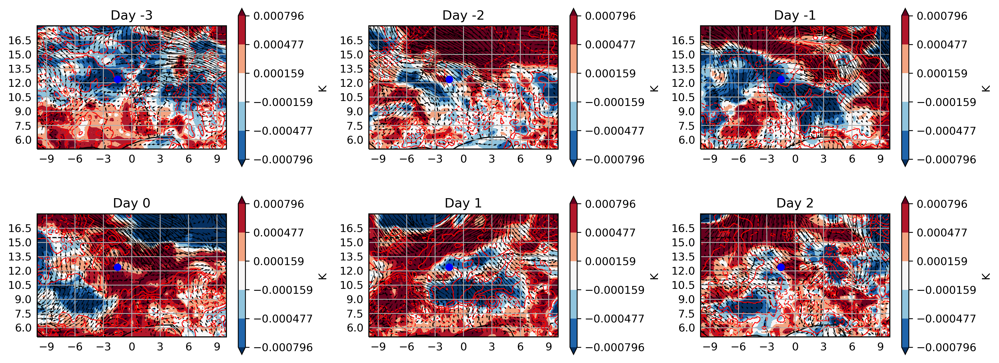

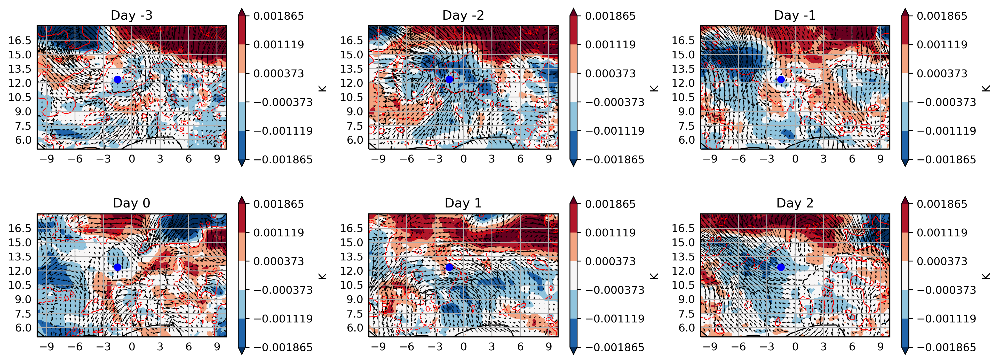

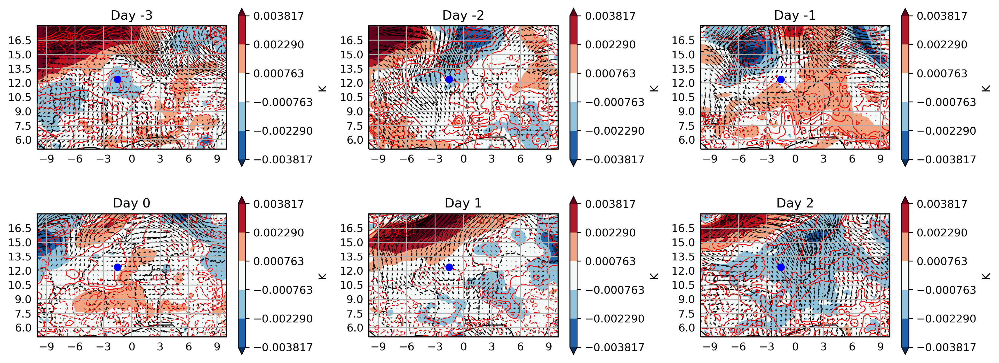

...

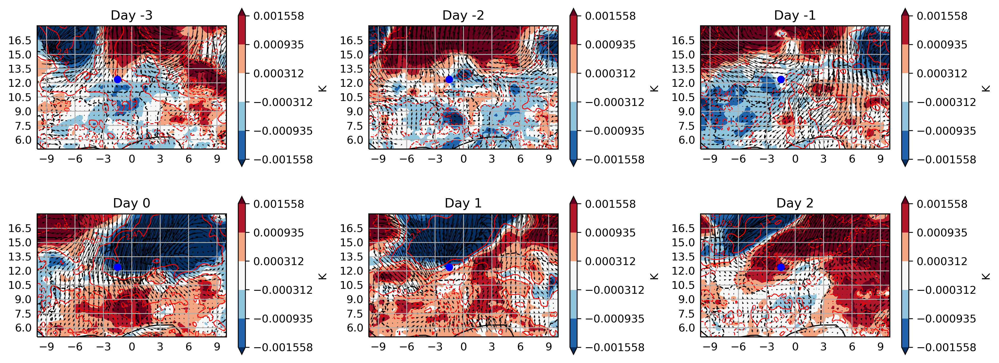

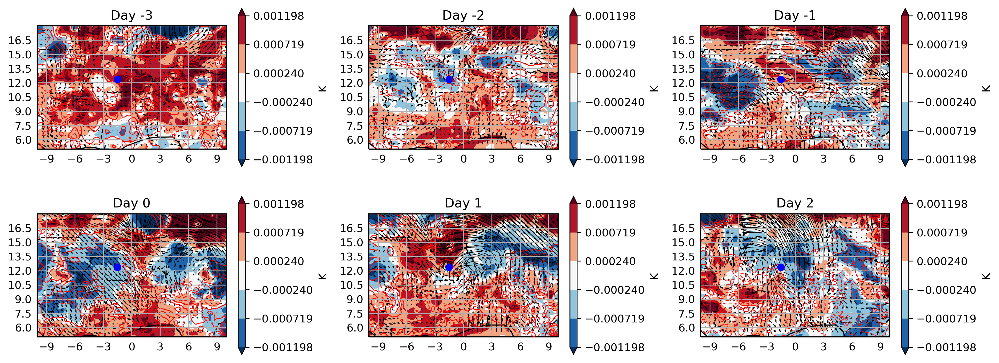

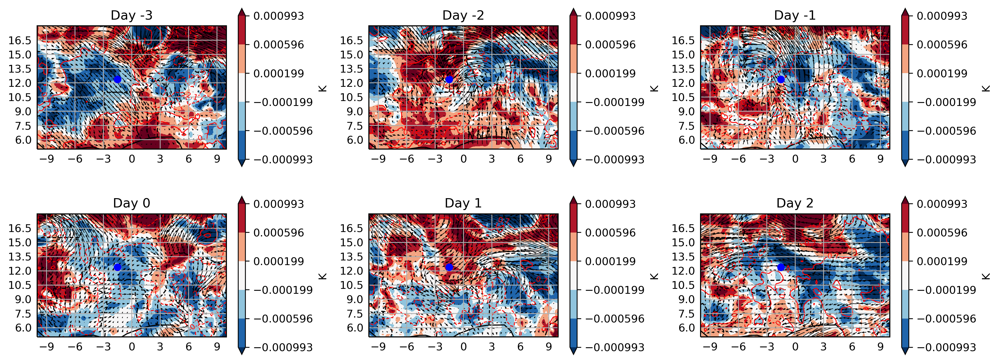

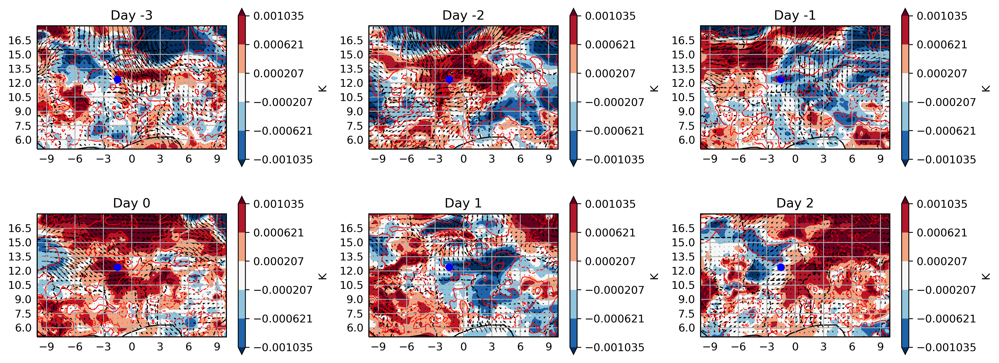

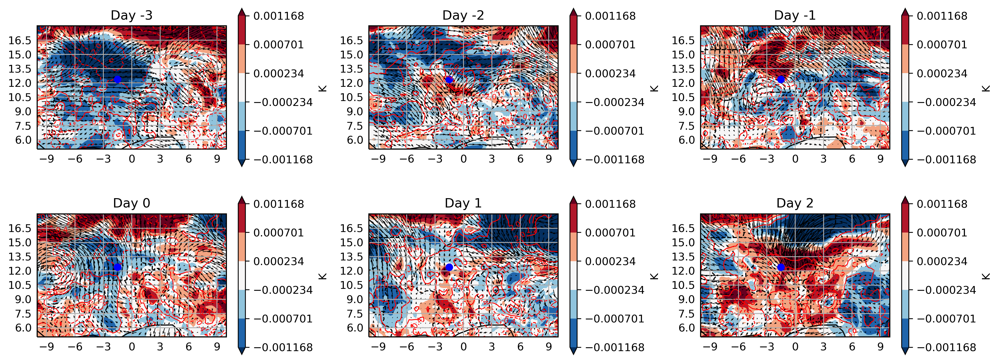

In [125]:
for dd in tab:
    dt = pd.to_datetime(dd)
    st=2
    sarrow = 2
    scale = 60
    utag = 'u100'
    vtag = 'v100'
    f = plt.figure(figsize=(13,5), dpi=300)

    for ids, num in enumerate([-3,-2,-1,0,1,2]):

        ax = f.add_subplot(2,3,ids+1, projection=ccrs.PlateCarree())
        print(num)
        dic, lat, lon = run(num, dd, 12)
        dic = calc(dic)

        if ids == 0:
            lon2d, lat2d = np.meshgrid(lon,lat)
            xquiv = lon2d[sarrow::st, sarrow::st]
            yquiv = lat2d[sarrow::st, sarrow::st]
        #ipdb.set_trace()

        ws, wd = u_met.u_v_to_ws_wd(dic['u_orig']-dic['u100_orig'], dic['v_orig']-dic['v100_orig'])
        var = dic['q']

        if ids == 0:
            edge = np.max([np.abs(np.percentile(var,10)),np.abs(np.percentile(var,90))])
            lev = np.linspace(edge*-1,edge,6) # edge*-1
        #ipdb.set_trace()
        u = dic[utag]
        v = dic[vtag]

        uu = u[sarrow::st, sarrow::st]
        vv = v[sarrow::st, sarrow::st]
        qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : scale}


        cvar = 't'
        invar = dic[cvar]
        if ids == 0:
            edge = np.max([np.abs(np.percentile(invar,10)),np.abs(np.percentile(invar,90))])
            levs = np.linspace(edge*-1,edge,6) # edge*-1
        contour = {'data' : invar, 'x' : lon, 'y' : lat, 'levels' : levs}

        draw_map(ax, var, lat, lon, title='Day '+str(num),  quiver=qin, levels=lev, contour=contour)  #levels=lev,

    f.canvas.draw()
    plt.tight_layout()
    plt.savefig(cnst.network_data + 'figs/LSTA/ERA5_eulerian/single_case/ERA5_q_t_u100_anom_12UTC_'+ 
                str(dt.year)+'-'+str(dt.month)+'-'+str(dt.day)+'.jpg')

## 